In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx

## Reading in the data

In [2]:
Essay = pd.read_excel('essayLog (sample).xlsx')
Trace = pd.read_excel('trace_data (sample).xlsx')

## Looking at our data

In [3]:
Essay.head()

,#,user_id,save_time,url,essay_content,essay_content_json,course_id
0,1,563,2024-12-24 10:30:33.387,https://flora.cite.hku.hk/moodle/mod/page/view...,L\n,"{""ops"":[{""insert"":""L\n""}]}",6
1,2,563,2024-12-24 10:30:33.628,https://flora.cite.hku.hk/moodle/mod/page/view...,La\n,"{""ops"":[{""insert"":""La\n""}]}",6
2,3,563,2024-12-24 10:30:34.279,https://flora.cite.hku.hk/moodle/mod/page/view...,Las\n,"{""ops"":[{""insert"":""Las\n""}]}",6
3,4,563,2024-12-24 10:30:34.739,https://flora.cite.hku.hk/moodle/mod/page/view...,Last\n,"{""ops"":[{""insert"":""Last\n""}]}",6
4,5,563,2024-12-24 10:30:36.169,https://flora.cite.hku.hk/moodle/mod/page/view...,Last \n,"{""ops"":[{""insert"":""Last \n""}]}",6


In [4]:
Trace.head()

,#,user_id,save_time,url,source,page_event,target_object,instant_event,sub_action_label,screenX,...,window_inner_width,window_inner_height,screen_width,screen_height,event_value,action_label,process_label,course_id,detailed_action_label,model_type
0,1,530,2025-01-02 18:56:36.629,https://flora.cite.hku.hk/moodle/mod/page/view...,TIMER,NO_PAGE_EVENT,NO_TARGET_OBJECT,ESSAY_TASK_START,START_TASK,NO_SCREEN_X,...,1440,837,1440,960,NaN,START,NaN,6,NaN,maria
1,2,530,2025-01-02 18:56:36.735,https://flora.cite.hku.hk/moodle/mod/page/view...,EXTRA,MOUSE_MOVE,IMG#NO_ID,NO_INSTANT_EVENT,PAGE_NAVIGATION,627,...,1440,837,1440,960,NaN,NAVIGATION,NaN,6,NaN,maria
2,3,530,2025-01-02 18:56:36.818,https://flora.cite.hku.hk/moodle/mod/page/view...,EXTRA,MOUSE_MOVE,IMG#NO_ID,NO_INSTANT_EVENT,PAGE_NAVIGATION,694,...,1440,837,1440,960,NaN,NAVIGATION,NaN,6,NaN,maria
3,4,530,2025-01-02 18:56:36.917,https://flora.cite.hku.hk/moodle/mod/page/view...,EXTRA,MOUSE_MOVE,IMG#NO_ID,NO_INSTANT_EVENT,PAGE_NAVIGATION,714,...,1440,837,1440,960,NaN,NAVIGATION,NaN,6,NaN,maria
4,5,530,2025-01-02 18:56:36.984,https://flora.cite.hku.hk/moodle/mod/page/view...,EXTRA,MOUSE_MOVE,IMG#NO_ID,NO_INSTANT_EVENT,PAGE_NAVIGATION,720,...,1440,837,1440,960,NaN,NAVIGATION,NaN,6,NaN,maria


## Finding the unique user ids in Essay dataset

In [5]:
Essay.user_id.unique()

array([563, 500, 504, 569, 439, 565, 430, 492, 431, 458, 438, 498, 559,
       434, 494, 530, 238, 532, 570, 465, 558, 566, 568, 435, 536, 495,
       564, 496, 562, 537, 432, 567, 468, 561, 503, 437, 436, 433, 461,
       467])

In [6]:
no_of_users_Essay = len(Essay.user_id.unique())
print(no_of_users_Essay)

40


## Finding the unique ids that exist in Trace dataset

In [7]:
Trace.user_id.unique()

array([530, 532, 533, 534, 536, 537, 430, 558, 431, 559, 432, 433, 561,
       434, 562, 435, 563, 436, 564, 437, 565, 438, 566, 439, 567, 568,
       569, 570, 458, 461, 462, 465, 467, 468, 472, 492, 238, 494, 495,
       496, 497, 498, 499, 500, 501, 503, 504])

In [8]:
no_of_users_Trace = len(Trace.user_id.unique())
print(no_of_users_Trace)

47


In [9]:
# Find elements in Trace that are not in Essay
unique_to_Trace = []
for user_id in Trace.user_id.unique():
    if user_id not in Essay.user_id.unique():
        unique_to_Trace.append(str(user_id))  # Convert to string while appending

print("Elements in Trace but not in Essay:", unique_to_Trace)

# Find elements in Essay that are not in Trace
unique_to_Essay = []
for user_id in Essay.user_id.unique():
    if user_id not in Trace.user_id.unique():
        unique_to_Essay.append(str(user_id))  # Convert to string while appending

print("Elements in Essay but not in Trace:", unique_to_Essay)

Elements in Trace but not in Essay: ['533', '534', '462', '472', '497', '499', '501']
Elements in Essay but not in Trace: []




*   From the above finding we can see that 462, 472, 497, 499, 501, 533, 534 exist in Trace but not in Essay.
*   And it makes sense that there are no elements that are unique to Essay. because if a student started to write the essay it would be recorded in the trace data.
*   From the Elements that are unique to Trace we can infer that these 7 students have not written an essay. Therefore can be dropped from our dataset as they do not provide any revelent information for our project





## List out value counts for each column (sorted by values)

In [10]:
# Get counts of unique values for each column in the Essay dataset
unique_counts_essay = {col: Essay[col].value_counts() for col in Essay.columns}

# Print the counts of unique values for each column
for col, counts in unique_counts_essay.items():
    print(f"Counts of unique values in column '{col}':\n{counts}\n")

Counts of unique values in column '#':
#
23182    1
1        1
2        1
3        1
4        1
        ..
19       1
18       1
17       1
16       1
15       1
Name: count, Length: 23182, dtype: int64

Counts of unique values in column 'user_id':
user_id
559    1798
564    1624
504    1611
435    1529
438    1385
432    1384
433    1359
500    1235
563    1178
437    1148
568    1045
570    1028
431     916
495     875
562     692
467     562
565     561
496     537
430     527
558     506
439     382
561     322
567     312
434     236
436     172
492      86
569      52
238      33
465      22
536      16
498      10
458       9
468       8
532       7
494       4
503       4
461       3
537       2
566       1
530       1
Name: count, dtype: int64

Counts of unique values in column 'save_time':
save_time
2025-01-02 22:55:54.795    2
2025-01-02 22:29:08.105    1
2025-01-02 22:29:06.003    1
2025-01-02 22:29:05.799    1
2025-01-02 22:29:05.494    1
                          ..
2025-

In [11]:
# Get counts of unique values for each column in the Trace dataset
unique_counts_trace = {col: Trace[col].value_counts() for col in Trace.columns}

# Print the counts of unique values for each column
for col, counts in unique_counts_trace.items():
    print(f"Counts of unique values in column '{col}':\n{counts}\n")

Counts of unique values in column '#':
#
2       47
1       47
3       47
4       46
6       46
        ..
6407     1
6406     1
6405     1
6404     1
6403     1
Name: count, Length: 6430, dtype: int64

Counts of unique values in column 'user_id':
user_id
568    6430
504    5932
439    5022
564    2106
433    2075
559    1835
432    1661
438    1596
435    1560
431    1509
530    1475
500    1338
570    1211
563    1199
437    1102
562     845
495     793
458     792
565     669
467     630
430     604
496     568
558     513
434     398
567     372
561     350
536     302
465     236
492     206
436     200
461     189
537     180
238     138
501     125
468     122
569      93
503      77
494      70
498      66
532      65
499      20
462      19
566      18
533      17
534       8
472       8
497       3
Name: count, dtype: int64

Counts of unique values in column 'save_time':
save_time
2025-01-28 12:46:46.176    4
2025-01-02 23:11:06.477    3
2025-01-02 22:45:37.988    3
2024-12-2

In [12]:
Trace.event_value.unique()

array([nan, 'SCROLL_DIST:::100', 'SCROLL_DIST:::200', ...,
       'PAGE_STAY_TIME_LENGTH:::2994', 'START_USE_TOOL:::1735817025685',
       'TOOL_USE_LENGTH:::3159'], dtype=object)

In [13]:
# Assuming Trace.event_value is your Series
# Set the display option to show all elements
pd.set_option('display.max_rows', None)  # None means no limit

# Get unique values and convert to a DataFrame
unique_values_df = pd.DataFrame(Trace.event_value.unique(), columns=['Unique Values'])

# Print the DataFrame
print(unique_values_df)

# Optionally, reset the display option to default after displaying
pd.reset_option('display.max_rows')

                                          Unique Values
0                                                   NaN
1                                     SCROLL_DIST:::100
2                                     SCROLL_DIST:::200
3                                    SCROLL_DIST:::-100
4                        START_USE_TOOL:::1735815427864
5                               TOOL_USE_LENGTH:::12197
6                        START_USE_TOOL:::1735815444278
7                              OFF_TASK_LENGTH:::348998
8                                   CURSOR_POSITION:::0
9                                       KEY::: ---Space
10                          KEY:::Backspace---Backspace
11                                      KEY:::,---Comma
12                            TOOL_USE_LENGTH:::3251848
13                             OFF_TASK_LENGTH:::348181
14                                   SCROLL_DIST:::-200
15                             OFF_TASK_LENGTH:::359005
16                       START_USE_TOOL:::173581

## List out value counts for each column (sorted by index)

In [14]:
# Get counts of unique values for each column in the Essay dataset and sort them
unique_counts_essay = {col: Essay[col].value_counts().sort_index() for col in Essay.columns}

# Print the counts of unique values for each column in ascending order
for col, counts in unique_counts_essay.items():
    print(f"Counts of unique values in column '{col}' (sorted in ascending order):\n{counts}\n")

Counts of unique values in column '#' (sorted in ascending order):
#
1        1
2        1
3        1
4        1
5        1
        ..
23178    1
23179    1
23180    1
23181    1
23182    1
Name: count, Length: 23182, dtype: int64

Counts of unique values in column 'user_id' (sorted in ascending order):
user_id
238      33
430     527
431     916
432    1384
433    1359
434     236
435    1529
436     172
437    1148
438    1385
439     382
458       9
461       3
465      22
467     562
468       8
492      86
494       4
495     875
496     537
498      10
500    1235
503       4
504    1611
530       1
532       7
536      16
537       2
558     506
559    1798
561     322
562     692
563    1178
564    1624
565     561
566       1
567     312
568    1045
569      52
570    1028
Name: count, dtype: int64

Counts of unique values in column 'save_time' (sorted in ascending order):
save_time
2024-12-24 10:30:33.387    1
2024-12-24 10:30:33.628    1
2024-12-24 10:30:34.279    1
2024-12-

In [15]:
# Get counts of unique values for each column in the Trace dataset and sort them
unique_counts_trace = {col: Trace[col].value_counts().sort_index() for col in Trace.columns}

# Print the counts of unique values for each column in ascending order
for col, counts in unique_counts_trace.items():
    print(f"Counts of unique values in column '{col}' (sorted in ascending order):\n{counts}\n")

Counts of unique values in column '#' (sorted in ascending order):
#
1       47
2       47
3       47
4       46
5       46
        ..
6426     1
6427     1
6428     1
6429     1
6430     1
Name: count, Length: 6430, dtype: int64

Counts of unique values in column 'user_id' (sorted in ascending order):
user_id
238     138
430     604
431    1509
432    1661
433    2075
434     398
435    1560
436     200
437    1102
438    1596
439    5022
458     792
461     189
462      19
465     236
467     630
468     122
472       8
492     206
494      70
495     793
496     568
497       3
498      66
499      20
500    1338
501     125
503      77
504    5932
530    1475
532      65
533      17
534       8
536     302
537     180
558     513
559    1835
561     350
562     845
563    1199
564    2106
565     669
566      18
567     372
568    6430
569      93
570    1211
Name: count, dtype: int64

Counts of unique values in column 'save_time' (sorted in ascending order):
save_time
2024-12-18 1

There are a total of 23 Features in the Trace data which are as follows


1. #
2. user_id
3. save_time
4. url
5. source
6. page_event
7. target_object
8. instant_event
9. sub_action_label
10. screen x
11. screen y
12. client x
13. client y
14. window_inner_width
15. window_inner_height
16. screen_width
17. screen_height
18. event_value
19. action_label
20. process_label
21. course_id
22. detailed_action_label
23. model_type






I have categorised these feature into 3 kinds - irrelevent, neutral, and useful. based on their usability to the project. irrelevent features are the features I deemed are not useful, likewise neutral features include the features that i have yet to find use for but not completely hopeless. Lastly useful features include all the features That I deemed to be relevent and useful for the project.


---


irrelevent - url, process_label, course_id, detailed_action_label, and model_type


---


neutral - #, save_time, page_event, target_object, screen x, screen y, client x, client y, window_inner_width, window_inner_height, screen_width, and screen_height

---


useful - user_id, source, instant_event, sub_action_label, event_value, and action_label


# Lets now look closely at the unique values of useful features.

## Lets look a User Activity over time

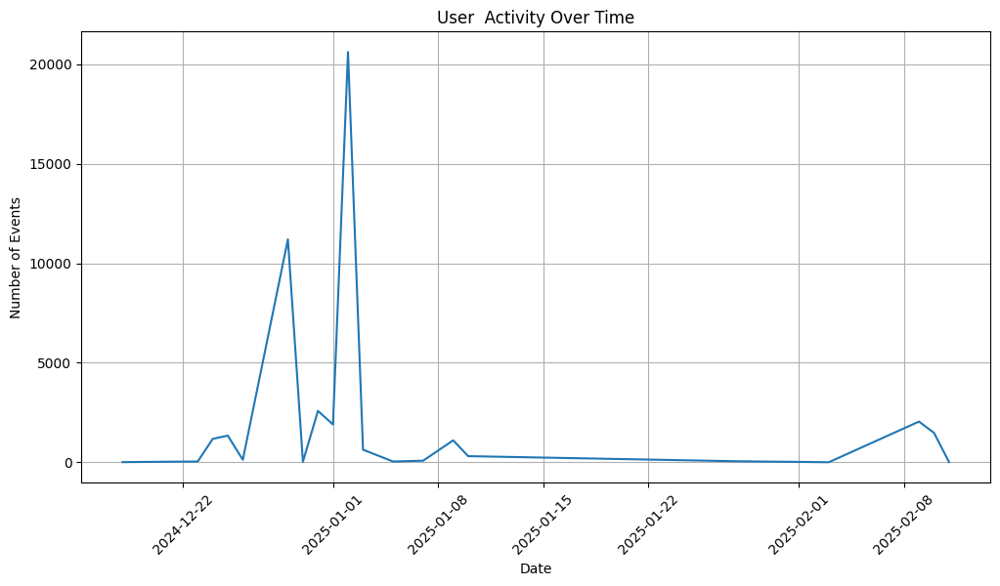

In [16]:
# Convert 'save_time' to datetime
Trace['save_time'] = pd.to_datetime(Trace['save_time'])

# Group by date and count the number of events
activity_per_day = Trace.groupby(Trace['save_time'].dt.date).size()

# Plotting
plt.figure(figsize=(12, 6))
activity_per_day.plot(kind='line')
plt.title('User  Activity Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Events')
plt.xticks(rotation=45)
plt.grid()
plt.show()

### Lets now find the unique action labels from Trace data.

In [17]:
Trace.user_id.unique()

array([530, 532, 533, 534, 536, 537, 430, 558, 431, 559, 432, 433, 561,
       434, 562, 435, 563, 436, 564, 437, 565, 438, 566, 439, 567, 568,
       569, 570, 458, 461, 462, 465, 467, 468, 472, 492, 238, 494, 495,
       496, 497, 498, 499, 500, 501, 503, 504])

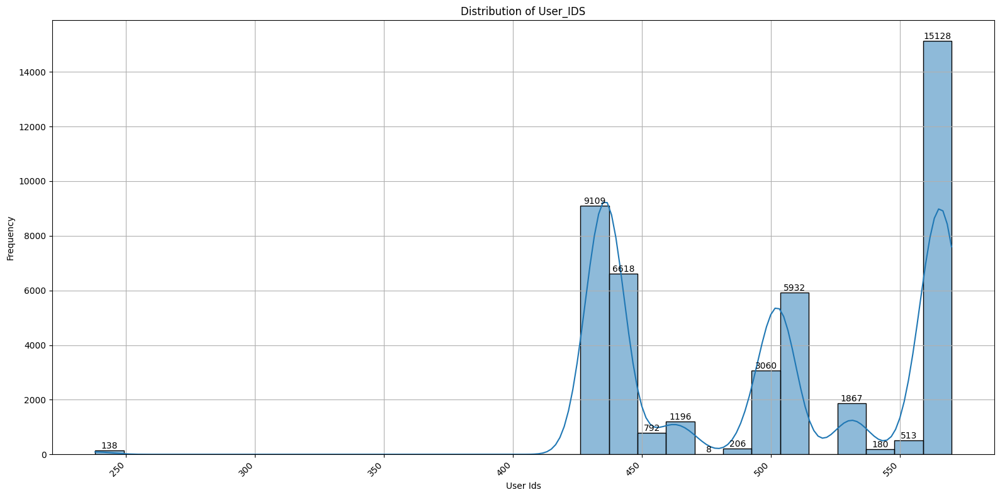

In [18]:
# Increase the figure size
plt.figure(figsize=(16, 8))  # Adjusted size for better visibility

# Create the histogram with KDE
hist = sns.histplot(Trace['user_id'], bins=30, kde=True)

# Set the title and labels
plt.title('Distribution of User_IDS')
plt.xlabel('User Ids')
plt.ylabel('Frequency')

# Rotate x-axis labels and adjust their position to avoid overlap
plt.xticks(rotation=45, ha='right')

# Annotate the bars with their heights
for p in hist.patches:
    height = p.get_height()
    if height > 0:  # Only annotate if height is greater than 0
        plt.annotate(f'{int(height)}',
                     (p.get_x() + p.get_width() / 2, height),
                     ha='center',
                     va='bottom',
                     fontsize=10)

# Adjust layout to prevent clipping of tick-labels
plt.tight_layout()

# Show grid and plot
plt.grid()
plt.show()

The Above graph is not very good as we can't distingish the user_ids and clearly because overlapping userids are aggregated.

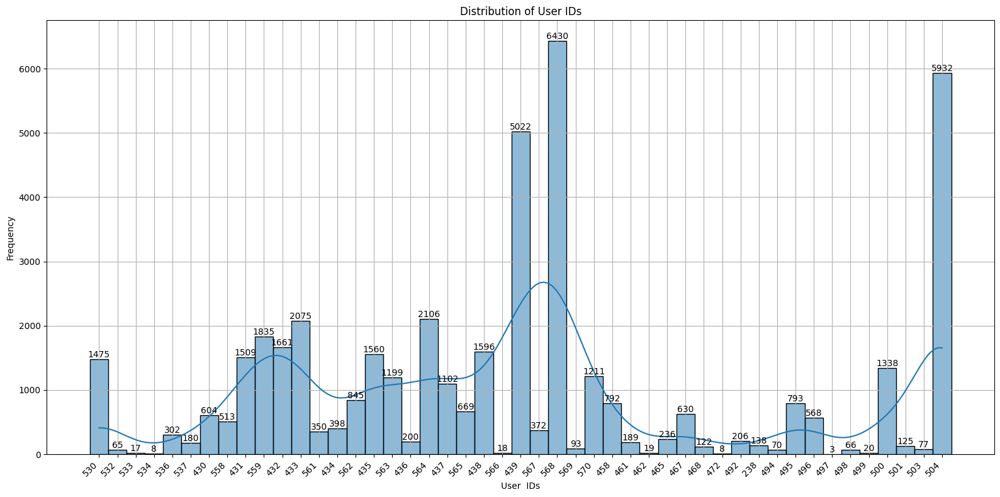

In [19]:
# Increase the figure size
plt.figure(figsize=(16, 8))  # Adjusted size for better visibility

# Convert user IDs to strings
Trace['user_id'] = Trace['user_id'].astype(str)

# Get unique user IDs
unique_user_ids = Trace['user_id'].unique()
num_unique_ids = len(unique_user_ids)

# Create the histogram with KDE
# Use the number of unique user_ids for bins
hist = sns.histplot(Trace['user_id'], bins=num_unique_ids, kde=True)

# Set the title and labels
plt.title('Distribution of User IDs')
plt.xlabel('User  IDs')
plt.ylabel('Frequency')

# Set x-ticks to show all unique user IDs
plt.xticks(rotation=45, ha='right')  # Rotate for better visibility

# Annotate the bars with their heights
for p in hist.patches:
    height = p.get_height()
    if height > 0:  # Only annotate if height is greater than 0
        plt.annotate(f'{int(height)}',
                     (p.get_x() + p.get_width() / 2, height),
                     ha='center',
                     va='bottom',
                     fontsize=10)

# Adjust layout to prevent clipping of tick-labels
plt.tight_layout()

# Show grid and plot
plt.grid()
plt.show()

### Lets now find the unique action labels from Trace data.

In [20]:
Trace.action_label.unique()

array(['START', 'NAVIGATION', 'READING', 'ESSAY', 'OFF_TASK', 'CHATGPT',
       'PLANNER', 'CHECKLIST', 'ANNOTATION', 'DICTIONARY',
       'SEARCH_ANNOTATION'], dtype=object)

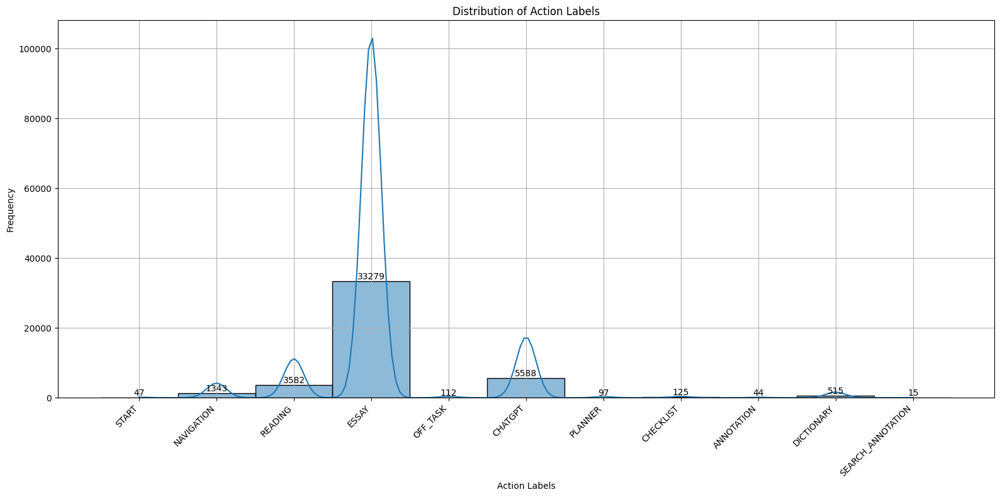

In [21]:
# Increase the figure size
plt.figure(figsize=(16, 8))  # Adjusted size for better visibility

# Create the histogram with KDE
hist = sns.histplot(Trace['action_label'], bins=30, kde=True)

# Set the title and labels
plt.title('Distribution of Action Labels')
plt.xlabel('Action Labels')
plt.ylabel('Frequency')

# Rotate x-axis labels and adjust their position to avoid overlap
plt.xticks(rotation=45, ha='right')

# Annotate the bars with their heights
for p in hist.patches:
    height = p.get_height()
    if height > 0:  # Only annotate if height is greater than 0
        plt.annotate(f'{int(height)}',
                     (p.get_x() + p.get_width() / 2, height),
                     ha='center',
                     va='bottom',
                     fontsize=10)

# Adjust layout to prevent clipping of tick-labels
plt.tight_layout()

# Show grid and plot
plt.grid()
plt.show()

## Lets now find the unique sub_action_label from Trace data.

In [22]:
Trace.sub_action_label.unique()

array(['START_TASK', 'PAGE_NAVIGATION', 'RELEVANT_READING', 'OPEN_ESSAY',
       'WRITE_ESSAY', 'CLOSE_ESSAY', 'OFF_TASK', 'TABLE_OF_CONTENT',
       'READ_FEEDBACK_GPT', 'OPEN_GPT', 'CLOSE_GPT', 'SAVE_ESSAY',
       'READ_PLANNER', 'OPEN_PLANNER', 'READ_CHECKLIST', 'CLOSE_PLANNER',
       'READ_BASIC_CHECKLIST', 'OPEN_CHECKLIST', 'READ_NaNNaN',
       'ANALYSE_BASIC_CHECKLIST', 'CLOSE_CHECKLIST', 'TRY_OUT_TOOLS',
       'READ_ANNOTATION', 'OPEN_DICTIONARY', 'ASK_GPT', 'DICTIONARY',
       'CLOSE_DICTIONARY', 'PASTE_TEXT_ESSAY', 'OPEN_CHATGPT',
       'RELEVANT_REREADING', 'CREATE_PLANNER', 'SEARCH_ANNOTATION',
       'OPEN_SEARCH_ANNOTATION', 'OPEN_ANNOTATION', 'CLOSE_ANNOTATION'],
      dtype=object)

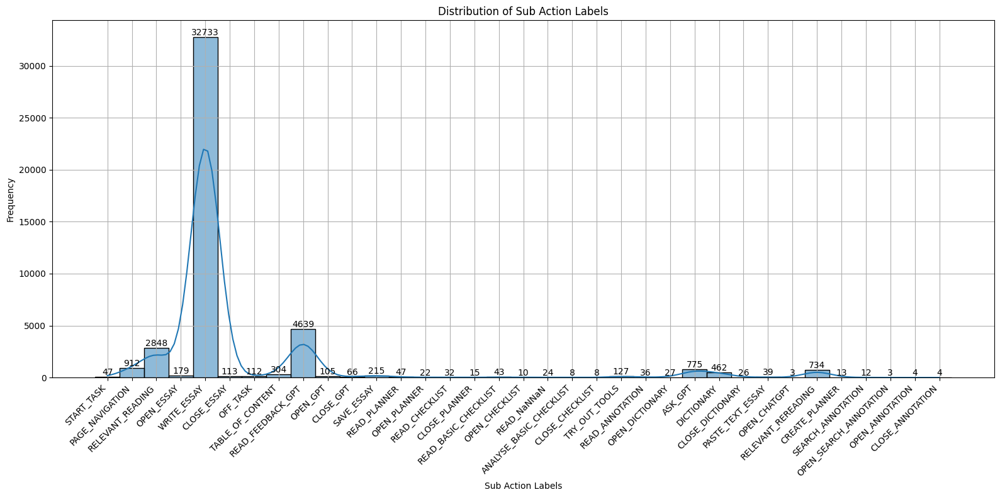

In [23]:
# Increase the figure size
plt.figure(figsize=(16, 8))  # Adjusted size for better visibility

# Create the histogram with KDE
hist = sns.histplot(Trace['sub_action_label'], bins=30, kde=True)

# Set the title and labels
plt.title('Distribution of Sub Action Labels')
plt.xlabel('Sub Action Labels')
plt.ylabel('Frequency')

# Rotate x-axis labels and adjust their position to avoid overlap
plt.xticks(rotation=45, ha='right')

# Annotate the bars with their heights
for p in hist.patches:
    height = p.get_height()
    if height > 0:  # Only annotate if height is greater than 0
        plt.annotate(f'{int(height)}',
                     (p.get_x() + p.get_width() / 2, height),
                     ha='center',
                     va='bottom',
                     fontsize=10)

# Adjust layout to prevent clipping of tick-labels
plt.tight_layout()

# Show grid and plot
plt.grid()
plt.show()

## Lets now find the unique Instant Event from Trace data.

In [24]:
Trace.instant_event.unique()

array(['ESSAY_TASK_START', 'NO_INSTANT_EVENT', 'OPEN',
       'BODY_CLICK_READING', 'CLICK', 'CLOSE', 'OFF_TASK', 'FOCUS',
       'WRITE', 'SHOW_CHATGPT_BTN_CLICK', 'BODY_CLICK_TABLE_OF_CONTENT',
       'SELECT_TEXT', 'LEAVE_PAGE', 'SAVE', 'SHOW_PLANNER_BTN_CLICK',
       'CHECKLIST_SHOW_BTN_CLICK', 'CHANGE_TO_BASIC_WRITING',
       'CLICK_BASIC', 'ANALYSE_BASIC', 'ANNOTATION_SIDE_BAR_BTN_CLICK',
       'BODY_CLICK_PAGE_NAVIGATION', 'WRITE_QUESTION', 'SUBMIT_QUESTION',
       'SUBMIT_WORD', 'WRITE_WORD', 'SHOW_DICTIONARY_BTN_CLICK',
       'PASTE_TEXT', 'CHANGE_PAGE_CLICK_PAGE_NAVIGATION', 'CHANGE_STYLE',
       'CHANGE_PAGE_CLICK_READING', 'CLICK_SECTION_TITLE',
       'SELECT_TEXT_READING', 'SHOW_SEARCH_ANNOTATION_BTN_CLICK',
       'SELECT_LEARNING_STRATEGY'], dtype=object)

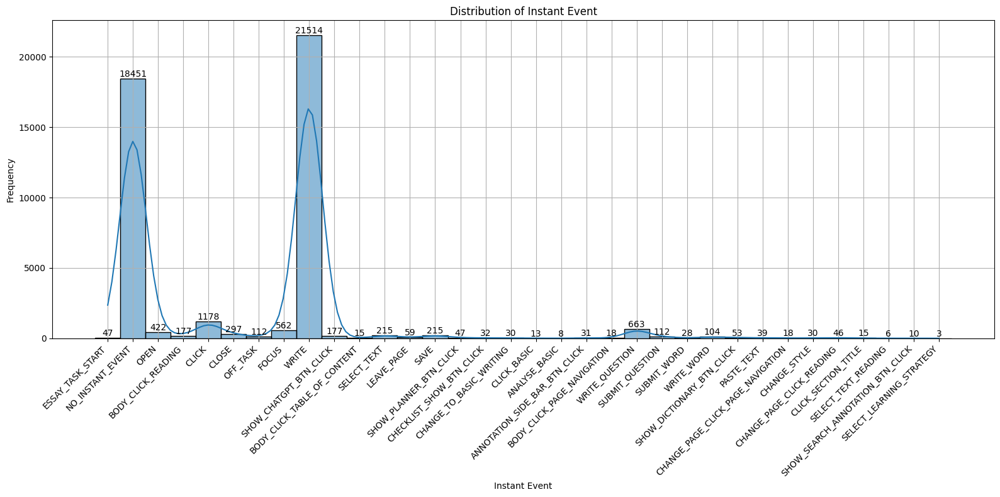

In [25]:
# Increase the figure size
plt.figure(figsize=(16, 8))  # Adjusted size for better visibility

# Create the histogram with KDE
hist = sns.histplot(Trace['instant_event'], bins=30, kde=True)

# Set the title and labels
plt.title('Distribution of Instant Event')
plt.xlabel('Instant Event')
plt.ylabel('Frequency')

# Rotate x-axis labels and adjust their position to avoid overlap
plt.xticks(rotation=45, ha='right')

# Annotate the bars with their heights
for p in hist.patches:
    height = p.get_height()
    if height > 0:  # Only annotate if height is greater than 0
        plt.annotate(f'{int(height)}',
                     (p.get_x() + p.get_width() / 2, height),
                     ha='center',
                     va='bottom',
                     fontsize=10)

# Adjust layout to prevent clipping of tick-labels
plt.tight_layout()

# Show grid and plot
plt.grid()
plt.show()

## Lets now find the unique source from Trace data.

In [26]:
Trace.source.unique()

array(['TIMER', 'EXTRA', 'ESSAY', 'OFF_TASK', 'CHATGPT', 'PAGE',
       'PLANNER', 'CHECKLIST', 'ANNOTATION', 'DICTIONARY',
       'SEARCH_ANNOTATION'], dtype=object)

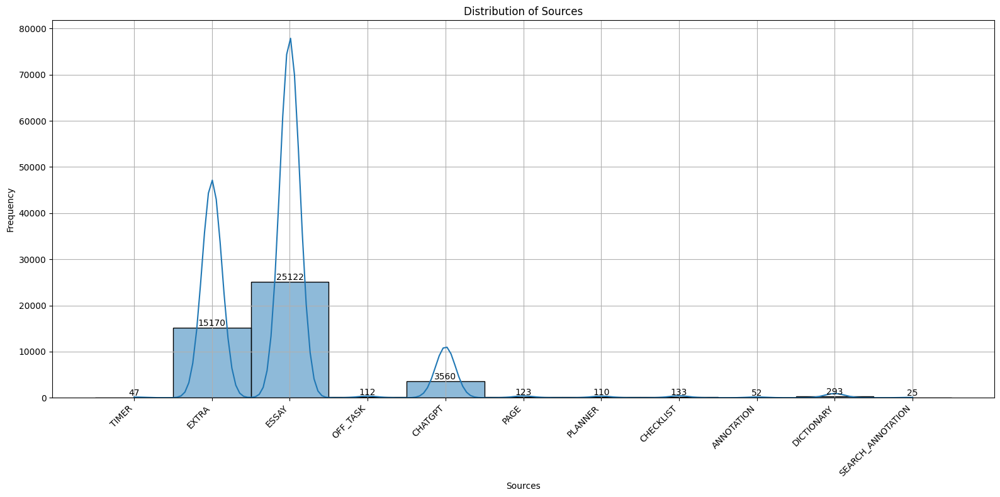

In [27]:
# Increase the figure size
plt.figure(figsize=(16, 8))  # Adjusted size for better visibility

# Create the histogram with KDE
hist = sns.histplot(Trace['source'], bins=30, kde=True)

# Set the title and labels
plt.title('Distribution of Sources')
plt.xlabel('Sources')
plt.ylabel('Frequency')

# Rotate x-axis labels and adjust their position to avoid overlap
plt.xticks(rotation=45, ha='right')

# Annotate the bars with their heights
for p in hist.patches:
    height = p.get_height()
    if height > 0:  # Only annotate if height is greater than 0
        plt.annotate(f'{int(height)}',
                     (p.get_x() + p.get_width() / 2, height),
                     ha='center',
                     va='bottom',
                     fontsize=10)

# Adjust layout to prevent clipping of tick-labels
plt.tight_layout()

# Show grid and plot
plt.grid()
plt.show()

## Lets now find the unique event_value from Trace data.

In [28]:
Trace.event_value.unique()

array([nan, 'SCROLL_DIST:::100', 'SCROLL_DIST:::200', ...,
       'PAGE_STAY_TIME_LENGTH:::2994', 'START_USE_TOOL:::1735817025685',
       'TOOL_USE_LENGTH:::3159'], dtype=object)

In [29]:
#Assuming Trace.event_value is your Series
# Set the display option to show all elements
pd.set_option('display.max_rows', None)  # None means no limit

# Get unique values and convert to a DataFrame
unique_values_df = pd.DataFrame(Trace.event_value.unique(), columns=['Unique Values'])

# Print the DataFrame
print(unique_values_df)

# Optionally, reset the display option to default after displaying
pd.reset_option('display.max_rows')

                                          Unique Values
0                                                   NaN
1                                     SCROLL_DIST:::100
2                                     SCROLL_DIST:::200
3                                    SCROLL_DIST:::-100
4                        START_USE_TOOL:::1735815427864
5                               TOOL_USE_LENGTH:::12197
6                        START_USE_TOOL:::1735815444278
7                              OFF_TASK_LENGTH:::348998
8                                   CURSOR_POSITION:::0
9                                       KEY::: ---Space
10                          KEY:::Backspace---Backspace
11                                      KEY:::,---Comma
12                            TOOL_USE_LENGTH:::3251848
13                             OFF_TASK_LENGTH:::348181
14                                   SCROLL_DIST:::-200
15                             OFF_TASK_LENGTH:::359005
16                       START_USE_TOOL:::173581

## There are way too many unique values!

In [30]:
# Increase the figure size
plt.figure(figsize=(16, 8))  # Adjusted size for better visibility

# Create the histogram with KDE
sns.histplot(Trace['event_value'], bins=30, kde=True)

# Set the title and labels
plt.title('Distribution of Event Values')
plt.xlabel('Event Value')
plt.ylabel('Frequency')

# Rotate x-axis labels and adjust their position to avoid overlap
plt.xticks(rotation=45, ha='right')  # 'ha' for horizontal alignment

# Adjust layout to prevent clipping of tick-labels
plt.tight_layout()

# Show grid and plot
plt.grid()
plt.show()

<ipython-input-30-d597a53f0a18>:16: UserWarning: Glyph 24320 (\N{CJK UNIFIED IDEOGRAPH-5F00}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-30-d597a53f0a18>:16: UserWarning: Glyph 22836 (\N{CJK UNIFIED IDEOGRAPH-5934}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-30-d597a53f0a18>:16: UserWarning: Glyph 65311 (\N{FULLWIDTH QUESTION MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-30-d597a53f0a18>:16: UserWarning: Glyph 29305 (\N{CJK UNIFIED IDEOGRAPH-7279}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-30-d597a53f0a18>:16: UserWarning: Glyph 21035 (\N{CJK UNIFIED IDEOGRAPH-522B}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-30-d597a53f0a18>:16: UserWarning: Glyph 30340 (\N{CJK UNIFIED IDEOGRAPH-7684}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
<ipython-input-30-d597a53f0a18>:16: UserWarning: Glyph 19968 (\N{CJK UNIFIED IDEOGRAPH-4E00}) missing from fo

We cannot visualize 'event values' the same way we could the other features due to too many unique values. So instead lets look into Event Values in more detail

## Splitting the Event values

Splitting the Event Values which are in (Key::: value) format into two columnns so that it would be easier to work with them.

In [31]:
# Sample data for demonstration
# Trace = pd.DataFrame({'instant_event': ['feature1:::value1', 'feature2:::value2', None, 'feature3:::value3']})

# Ensure the 'instant_event' column is of string type to avoid errors with None values
Trace['event_value'] = Trace['event_value'].astype(str)

# Split the 'instant_event' column into two new columns
Trace[['Event_value.feature', 'Event_value.value']] = Trace['event_value'].str.split(':::', expand=True)

# Optionally, you can drop the original 'instant_event' column if it's no longer needed
# Trace.drop(columns=['instant_event'], inplace=True)

# Display the modified DataFrame
print(Trace)

          # user_id               save_time  \
0         1     530 2025-01-02 18:56:36.629   
1         2     530 2025-01-02 18:56:36.735   
2         3     530 2025-01-02 18:56:36.818   
3         4     530 2025-01-02 18:56:36.917   
4         5     530 2025-01-02 18:56:36.984   
...     ...     ...                     ...   
44742  5928     504 2024-12-29 21:47:32.651   
44743  5929     504 2025-01-02 19:23:45.678   
44744  5930     504 2025-01-02 19:23:45.685   
44745  5931     504 2025-01-02 19:23:48.841   
44746  5932     504 2025-01-02 19:23:48.844   

                                                     url source  \
0      https://flora.cite.hku.hk/moodle/mod/page/view...  TIMER   
1      https://flora.cite.hku.hk/moodle/mod/page/view...  EXTRA   
2      https://flora.cite.hku.hk/moodle/mod/page/view...  EXTRA   
3      https://flora.cite.hku.hk/moodle/mod/page/view...  EXTRA   
4      https://flora.cite.hku.hk/moodle/mod/page/view...  EXTRA   
...                              

In [32]:
# looking at a row that has Submit as its key and a sentence as its value
print(Trace.iloc[1645])

#                                                                       81
user_id                                                                536
save_time                                       2025-01-02 21:34:35.226000
url                      https://flora.cite.hku.hk/moodle/mod/page/view...
source                                                             CHATGPT
page_event                                                     MOUSE_CLICK
target_object                                     CHATGPT_PANEL_SUBMIT_BTN
instant_event                                              SUBMIT_QUESTION
sub_action_label                                                   ASK_GPT
screenX                                                                238
screenY                                                                615
clientX                                                                238
clientY                                                                615
window_inner_width       

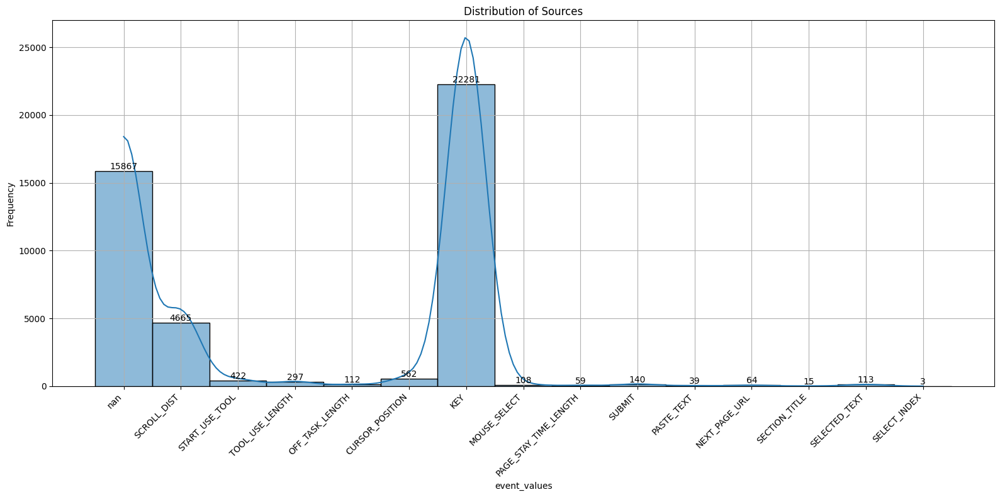

In [33]:
# Increase the figure size
plt.figure(figsize=(16, 8))  # Adjusted size for better visibility

# Create the histogram with KDE
hist = sns.histplot(Trace['Event_value.feature'], bins=30, kde=True)

# Set the title and labels
plt.title('Distribution of Sources')
plt.xlabel('event_values')
plt.ylabel('Frequency')

# Rotate x-axis labels and adjust their position to avoid overlap
plt.xticks(rotation=45, ha='right')

# Annotate the bars with their heights
for p in hist.patches:
    height = p.get_height()
    if height > 0:  # Only annotate if height is greater than 0
        plt.annotate(f'{int(height)}',
                     (p.get_x() + p.get_width() / 2, height),
                     ha='center',
                     va='bottom',
                     fontsize=10)

# Adjust layout to prevent clipping of tick-labels
plt.tight_layout()

# Show grid and plot
plt.grid()
plt.show()

In [34]:
# Filter the DataFrame for rows where Event_value.feature is 'submit'
submit_df = Trace[Trace['Event_value.feature'] == 'SUBMIT']

# Display the filtered DataFrame
submit_df

,#,user_id,save_time,url,source,page_event,target_object,instant_event,sub_action_label,screenX,...,screen_width,screen_height,event_value,action_label,process_label,course_id,detailed_action_label,model_type,Event_value.feature,Event_value.value
1645,81,536,2025-01-02 21:34:35.226,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,MOUSE_CLICK,CHATGPT_PANEL_SUBMIT_BTN,SUBMIT_QUESTION,ASK_GPT,238,...,375,812,SUBMIT:::how can the right again开头？,CHATGPT,NaN,6,NaN,maria,SUBMIT,how can the right again开头？
1649,85,536,2025-01-02 21:34:58.261,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,MOUSE_CLICK,CHATGPT_PANEL_SUBMIT_BTN,SUBMIT_QUESTION,ASK_GPT,645,...,375,812,SUBMIT:::How can I write a good title?,CHATGPT,NaN,6,NaN,maria,SUBMIT,How can I write a good title?
1657,93,536,2025-01-02 21:37:33.266,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::What’s a different day?,DICTIONARY,NaN,6,NaN,maria,SUBMIT,What’s a different day?
1664,100,536,2025-01-02 21:37:55.734,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::What’s a different day!,DICTIONARY,NaN,6,NaN,maria,SUBMIT,What’s a different day!
1665,101,536,2025-01-02 21:38:10.208,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::特别的一天,DICTIONARY,NaN,6,NaN,maria,SUBMIT,特别的一天
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43004,4190,504,2024-12-29 21:38:01.297,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,1440,900,SUBMIT:::m,CHATGPT,NaN,6,NaN,maria,SUBMIT,m
43782,4968,504,2024-12-29 21:44:08.297,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,1440,900,SUBMIT:::m,CHATGPT,NaN,6,NaN,maria,SUBMIT,m
44037,5223,504,2024-12-29 21:44:44.460,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,1440,900,SUBMIT:::m,CHATGPT,NaN,6,NaN,maria,SUBMIT,m
44102,5288,504,2024-12-29 21:45:11.392,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,1440,900,SUBMIT:::m,CHATGPT,NaN,6,NaN,maria,SUBMIT,m


### There are only 140 rows with "SUBMIT" event value.

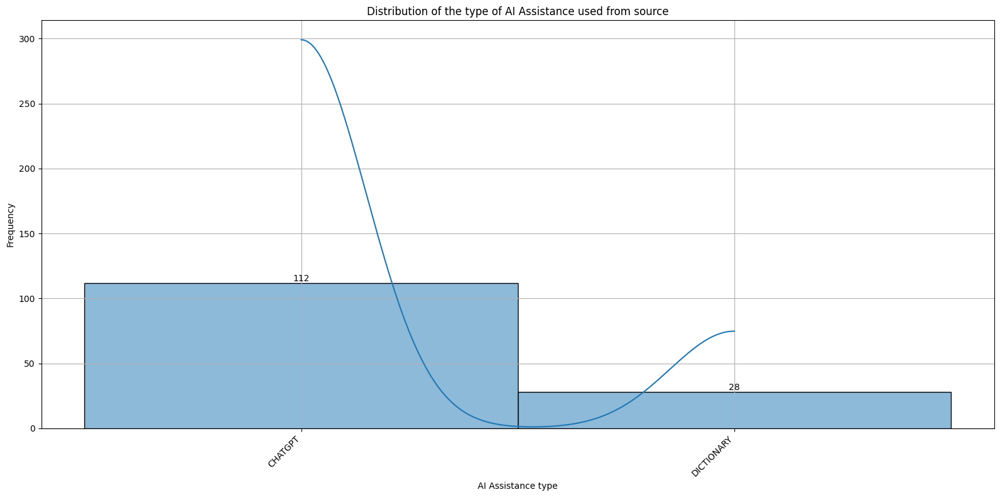

In [35]:
# Increase the figure size
plt.figure(figsize=(16, 8))  # Adjusted size for better visibility

# Create the histogram with KDE
hist = sns.histplot(submit_df['source'], bins=30, kde=True)

# Set the title and labels
plt.title('Distribution of the type of AI Assistance used from source')
plt.xlabel('AI Assistance type')
plt.ylabel('Frequency')

# Rotate x-axis labels and adjust their position to avoid overlap
plt.xticks(rotation=45, ha='right')

# Annotate the bars with their heights
for p in hist.patches:
    height = p.get_height()
    if height > 0:  # Only annotate if height is greater than 0
        plt.annotate(f'{int(height)}',
                     (p.get_x() + p.get_width() / 2, height),
                     ha='center',
                     va='bottom',
                     fontsize=10)

# Adjust layout to prevent clipping of tick-labels
plt.tight_layout()

# Show grid and plot
plt.grid()
plt.show()

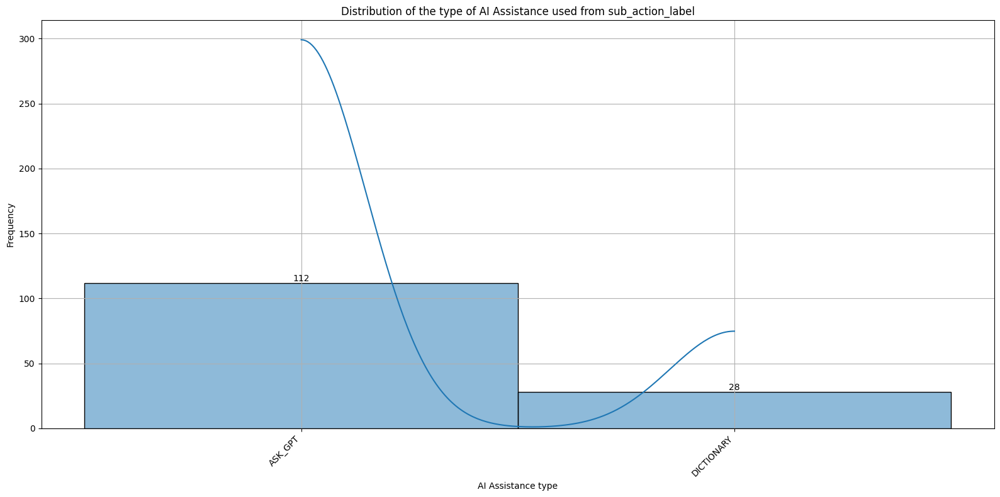

In [36]:
# Increase the figure size
plt.figure(figsize=(16, 8))  # Adjusted size for better visibility

# Create the histogram with KDE
hist = sns.histplot(submit_df['sub_action_label'], bins=30, kde=True)

# Set the title and labels
plt.title('Distribution of the type of AI Assistance used from sub_action_label')
plt.xlabel('AI Assistance type')
plt.ylabel('Frequency')

# Rotate x-axis labels and adjust their position to avoid overlap
plt.xticks(rotation=45, ha='right')

# Annotate the bars with their heights
for p in hist.patches:
    height = p.get_height()
    if height > 0:  # Only annotate if height is greater than 0
        plt.annotate(f'{int(height)}',
                     (p.get_x() + p.get_width() / 2, height),
                     ha='center',
                     va='bottom',
                     fontsize=10)

# Adjust layout to prevent clipping of tick-labels
plt.tight_layout()

# Show grid and plot
plt.grid()
plt.show()

Both the source and sub_action_label are showing the same.

lets further breakdown this dataset into a dictionary and ChatGPT so that we can look at them manually and see how exactly the students are using the AI

In [37]:
# Filter the DataFrame for rows where Source is 'CHATGPT'
CHATGPT = submit_df[submit_df['source'] == 'CHATGPT']

# Display the filtered DataFrame
CHATGPT

,#,user_id,save_time,url,source,page_event,target_object,instant_event,sub_action_label,screenX,...,screen_width,screen_height,event_value,action_label,process_label,course_id,detailed_action_label,model_type,Event_value.feature,Event_value.value
1645,81,536,2025-01-02 21:34:35.226,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,MOUSE_CLICK,CHATGPT_PANEL_SUBMIT_BTN,SUBMIT_QUESTION,ASK_GPT,238,...,375,812,SUBMIT:::how can the right again开头？,CHATGPT,NaN,6,NaN,maria,SUBMIT,how can the right again开头？
1649,85,536,2025-01-02 21:34:58.261,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,MOUSE_CLICK,CHATGPT_PANEL_SUBMIT_BTN,SUBMIT_QUESTION,ASK_GPT,645,...,375,812,SUBMIT:::How can I write a good title?,CHATGPT,NaN,6,NaN,maria,SUBMIT,How can I write a good title?
1721,157,536,2025-01-02 21:41:09.796,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,375,812,SUBMIT:::How can I write a good opening,CHATGPT,NaN,6,NaN,maria,SUBMIT,How can I write a good opening
1826,262,536,2025-01-02 21:58:25.338,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,MOUSE_CLICK,CHATGPT_PANEL_SUBMIT_BTN,SUBMIT_QUESTION,ASK_GPT,638,...,375,812,SUBMIT:::Can you give me a example of title,CHATGPT,NaN,6,NaN,maria,SUBMIT,Can you give me a example of title
1861,297,536,2025-01-02 23:27:04.289,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,MOUSE_CLICK,CHATGPT_PANEL_SUBMIT_BTN,SUBMIT_QUESTION,ASK_GPT,236,...,375,812,SUBMIT:::M,CHATGPT,NaN,6,NaN,maria,SUBMIT,M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43004,4190,504,2024-12-29 21:38:01.297,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,1440,900,SUBMIT:::m,CHATGPT,NaN,6,NaN,maria,SUBMIT,m
43782,4968,504,2024-12-29 21:44:08.297,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,1440,900,SUBMIT:::m,CHATGPT,NaN,6,NaN,maria,SUBMIT,m
44037,5223,504,2024-12-29 21:44:44.460,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,1440,900,SUBMIT:::m,CHATGPT,NaN,6,NaN,maria,SUBMIT,m
44102,5288,504,2024-12-29 21:45:11.392,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,1440,900,SUBMIT:::m,CHATGPT,NaN,6,NaN,maria,SUBMIT,m


In [38]:
# Filter the DataFrame for rows where Source is 'DICTIONARY'
CHATGPT = submit_df[submit_df['source'] == 'DICTIONARY']

# Display the filtered DataFrame
CHATGPT

,#,user_id,save_time,url,source,page_event,target_object,instant_event,sub_action_label,screenX,...,screen_width,screen_height,event_value,action_label,process_label,course_id,detailed_action_label,model_type,Event_value.feature,Event_value.value
1657,93,536,2025-01-02 21:37:33.266,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::What’s a different day?,DICTIONARY,NaN,6,NaN,maria,SUBMIT,What’s a different day?
1664,100,536,2025-01-02 21:37:55.734,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::What’s a different day!,DICTIONARY,NaN,6,NaN,maria,SUBMIT,What’s a different day!
1665,101,536,2025-01-02 21:38:10.208,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::特别的一天,DICTIONARY,NaN,6,NaN,maria,SUBMIT,特别的一天
1701,137,536,2025-01-02 21:40:12.099,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::What’s an unforgettable day!,DICTIONARY,NaN,6,NaN,maria,SUBMIT,What’s an unforgettable day!
1703,139,536,2025-01-02 21:40:23.923,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::undefined,DICTIONARY,NaN,6,NaN,maria,SUBMIT,undefined
1763,199,536,2025-01-02 21:55:42.683,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::Rising,DICTIONARY,NaN,6,NaN,maria,SUBMIT,Rising
1780,216,536,2025-01-02 21:56:07.518,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,MOUSE_CLICK,DICTIONARY_PANEL_SUBMIT_BTN,SUBMIT_WORD,DICTIONARY,231,...,375,812,SUBMIT:::Rising action,DICTIONARY,NaN,6,NaN,maria,SUBMIT,Rising action
1784,220,536,2025-01-02 21:57:11.996,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,MOUSE_CLICK,DICTIONARY_PANEL_SUBMIT_BTN,SUBMIT_WORD,DICTIONARY,232,...,375,812,SUBMIT:::,DICTIONARY,NaN,6,NaN,maria,SUBMIT,
1786,222,536,2025-01-02 21:57:13.500,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,MOUSE_CLICK,DICTIONARY_PANEL_SUBMIT_BTN,SUBMIT_WORD,DICTIONARY,228,...,375,812,SUBMIT:::,DICTIONARY,NaN,6,NaN,maria,SUBMIT,
1790,226,536,2025-01-02 21:57:36.871,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,MOUSE_CLICK,DICTIONARY_PANEL_SUBMIT_BTN,SUBMIT_WORD,DICTIONARY,214,...,375,812,SUBMIT:::,DICTIONARY,NaN,6,NaN,maria,SUBMIT,


In [39]:
submit_df['Event_value.value'] = submit_df['Event_value.value'].str.strip().replace("", np.nan)

DICTIONARY = submit_df[(submit_df['source'] == 'DICTIONARY') & (submit_df['Event_value.value'].notna())]
# Display the filtered DataFrame
DICTIONARY

<ipython-input-39-08d0fa9b02e3>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  submit_df['Event_value.value'] = submit_df['Event_value.value'].str.strip().replace("", np.nan)


,#,user_id,save_time,url,source,page_event,target_object,instant_event,sub_action_label,screenX,...,screen_width,screen_height,event_value,action_label,process_label,course_id,detailed_action_label,model_type,Event_value.feature,Event_value.value
1657,93,536,2025-01-02 21:37:33.266,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::What’s a different day?,DICTIONARY,NaN,6,NaN,maria,SUBMIT,What’s a different day?
1664,100,536,2025-01-02 21:37:55.734,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::What’s a different day!,DICTIONARY,NaN,6,NaN,maria,SUBMIT,What’s a different day!
1665,101,536,2025-01-02 21:38:10.208,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::特别的一天,DICTIONARY,NaN,6,NaN,maria,SUBMIT,特别的一天
1701,137,536,2025-01-02 21:40:12.099,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::What’s an unforgettable day!,DICTIONARY,NaN,6,NaN,maria,SUBMIT,What’s an unforgettable day!
1703,139,536,2025-01-02 21:40:23.923,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::undefined,DICTIONARY,NaN,6,NaN,maria,SUBMIT,undefined
1763,199,536,2025-01-02 21:55:42.683,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,375,812,SUBMIT:::Rising,DICTIONARY,NaN,6,NaN,maria,SUBMIT,Rising
1780,216,536,2025-01-02 21:56:07.518,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,MOUSE_CLICK,DICTIONARY_PANEL_SUBMIT_BTN,SUBMIT_WORD,DICTIONARY,231,...,375,812,SUBMIT:::Rising action,DICTIONARY,NaN,6,NaN,maria,SUBMIT,Rising action
6633,126,432,2025-01-02 22:49:44.314,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,MOUSE_CLICK,DICTIONARY_PANEL_SUBMIT_BTN,SUBMIT_WORD,DICTIONARY,989,...,810,1080,SUBMIT:::Screaming,DICTIONARY,NaN,6,NaN,maria,SUBMIT,Screaming
6658,151,432,2025-01-02 22:50:01.841,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,810,1080,SUBMIT:::Good experiment,DICTIONARY,NaN,6,NaN,maria,SUBMIT,Good experiment
6692,185,432,2025-01-02 22:50:26.442,https://flora.cite.hku.hk/moodle/mod/page/view...,DICTIONARY,KEY_STROKE,DICTIONARY_PANEL_INPUT,SUBMIT_WORD,DICTIONARY,NaN,...,810,1080,SUBMIT:::Gold experiment,DICTIONARY,NaN,6,NaN,maria,SUBMIT,Gold experiment


In [40]:
CHATGPT = submit_df[submit_df['source'] == 'CHATGPT']

CHATGPT

,#,user_id,save_time,url,source,page_event,target_object,instant_event,sub_action_label,screenX,...,screen_width,screen_height,event_value,action_label,process_label,course_id,detailed_action_label,model_type,Event_value.feature,Event_value.value
1645,81,536,2025-01-02 21:34:35.226,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,MOUSE_CLICK,CHATGPT_PANEL_SUBMIT_BTN,SUBMIT_QUESTION,ASK_GPT,238,...,375,812,SUBMIT:::how can the right again开头？,CHATGPT,NaN,6,NaN,maria,SUBMIT,how can the right again开头？
1649,85,536,2025-01-02 21:34:58.261,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,MOUSE_CLICK,CHATGPT_PANEL_SUBMIT_BTN,SUBMIT_QUESTION,ASK_GPT,645,...,375,812,SUBMIT:::How can I write a good title?,CHATGPT,NaN,6,NaN,maria,SUBMIT,How can I write a good title?
1721,157,536,2025-01-02 21:41:09.796,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,375,812,SUBMIT:::How can I write a good opening,CHATGPT,NaN,6,NaN,maria,SUBMIT,How can I write a good opening
1826,262,536,2025-01-02 21:58:25.338,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,MOUSE_CLICK,CHATGPT_PANEL_SUBMIT_BTN,SUBMIT_QUESTION,ASK_GPT,638,...,375,812,SUBMIT:::Can you give me a example of title,CHATGPT,NaN,6,NaN,maria,SUBMIT,Can you give me a example of title
1861,297,536,2025-01-02 23:27:04.289,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,MOUSE_CLICK,CHATGPT_PANEL_SUBMIT_BTN,SUBMIT_QUESTION,ASK_GPT,236,...,375,812,SUBMIT:::M,CHATGPT,NaN,6,NaN,maria,SUBMIT,M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43004,4190,504,2024-12-29 21:38:01.297,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,1440,900,SUBMIT:::m,CHATGPT,NaN,6,NaN,maria,SUBMIT,m
43782,4968,504,2024-12-29 21:44:08.297,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,1440,900,SUBMIT:::m,CHATGPT,NaN,6,NaN,maria,SUBMIT,m
44037,5223,504,2024-12-29 21:44:44.460,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,1440,900,SUBMIT:::m,CHATGPT,NaN,6,NaN,maria,SUBMIT,m
44102,5288,504,2024-12-29 21:45:11.392,https://flora.cite.hku.hk/moodle/mod/page/view...,CHATGPT,KEY_STROKE,CHATGPT_PANEL_INPUT,SUBMIT_QUESTION,ASK_GPT,NaN,...,1440,900,SUBMIT:::m,CHATGPT,NaN,6,NaN,maria,SUBMIT,m


In [41]:
pd.set_option('display.max_rows', None)  # None means no limit

# Get unique values and convert to a DataFrame
unique_values_df = pd.DataFrame(Trace.event_value.unique(), columns=['Unique Values'])

# Print the DataFrame
print(unique_values_df)

# Optionally, reset the display option to default after displaying
pd.reset_option('display.max_rows')

                                          Unique Values
0                                                   nan
1                                     SCROLL_DIST:::100
2                                     SCROLL_DIST:::200
3                                    SCROLL_DIST:::-100
4                        START_USE_TOOL:::1735815427864
5                               TOOL_USE_LENGTH:::12197
6                        START_USE_TOOL:::1735815444278
7                              OFF_TASK_LENGTH:::348998
8                                   CURSOR_POSITION:::0
9                                       KEY::: ---Space
10                          KEY:::Backspace---Backspace
11                                      KEY:::,---Comma
12                            TOOL_USE_LENGTH:::3251848
13                             OFF_TASK_LENGTH:::348181
14                                   SCROLL_DIST:::-200
15                             OFF_TASK_LENGTH:::359005
16                       START_USE_TOOL:::173581

In [42]:
# Set pandas options to display all rows
pd.set_option('display.max_rows', None)  # None means no limit
# Display the filtered DataFrame
print(CHATGPT)
# Optionally, reset the display option to default after displaying
pd.reset_option('display.max_rows')

          # user_id               save_time  \
1645     81     536 2025-01-02 21:34:35.226   
1649     85     536 2025-01-02 21:34:58.261   
1721    157     536 2025-01-02 21:41:09.796   
1826    262     536 2025-01-02 21:58:25.338   
1861    297     536 2025-01-02 23:27:04.289   
1866    302     536 2025-01-02 23:27:18.353   
1889     23     537 2025-01-02 20:37:08.053   
1921     55     537 2025-01-02 22:27:23.504   
1952     86     537 2025-01-02 22:28:34.320   
1964     98     537 2025-01-02 22:29:23.176   
1985    119     537 2025-01-02 22:32:04.178   
1989    123     537 2025-01-02 22:32:12.758   
2618    572     430 2024-12-31 13:04:16.466   
3199     36     431 2024-12-31 20:32:54.680   
3201     38     431 2024-12-31 20:32:57.131   
3203     40     431 2024-12-31 20:32:57.615   
3205     42     431 2024-12-31 20:32:57.798   
3207     44     431 2024-12-31 20:32:58.481   
4283   1120     431 2025-01-01 18:37:46.100   
4285   1122     431 2025-01-01 18:37:47.483   
4287   1124  

## Creating a network graph showing the various categories and their transitions along with their frequencies

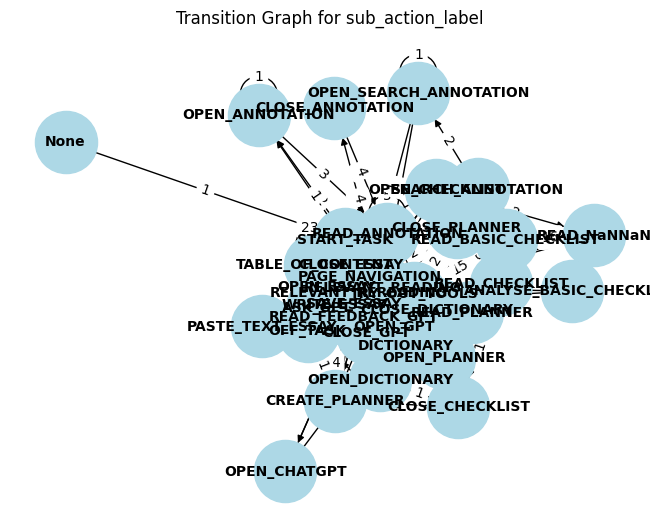

In [43]:
def process_analytics(df, feature):
    # Create a directed graph
    G = nx.DiGraph()
    # Count transitions
    transitions = df[feature].shift().astype(str) + ' -> ' + df[feature].astype(str)
    transition_counts = transitions.value_counts()
    # Add edges to the graph
    for transition, count in transition_counts.items():
        from_node, to_node = transition.split(' -> ')
        G.add_edge(from_node, to_node, weight=count)
    # Draw the graph
    pos = nx.spring_layout(G)
    weights = nx.get_edge_attributes(G, 'weight')
    nx.draw(G, pos, with_labels=True, node_size=2000, node_color='lightblue', font_size=10, font_weight='bold')
    nx.draw_networkx_edge_labels(G, pos, edge_labels=weights)
    plt.title(f'Transition Graph for {feature}')
    plt.show()
# Example usage
#data = {
#    'Category': ['A', 'B', 'A', 'C', 'B', 'A', 'C', 'A', 'B', 'C']
#}
#df = pd.DataFrame(data)
process_analytics(Trace, 'sub_action_label')

The above graph is too messy lets see if increasing the figure size can make it more clean

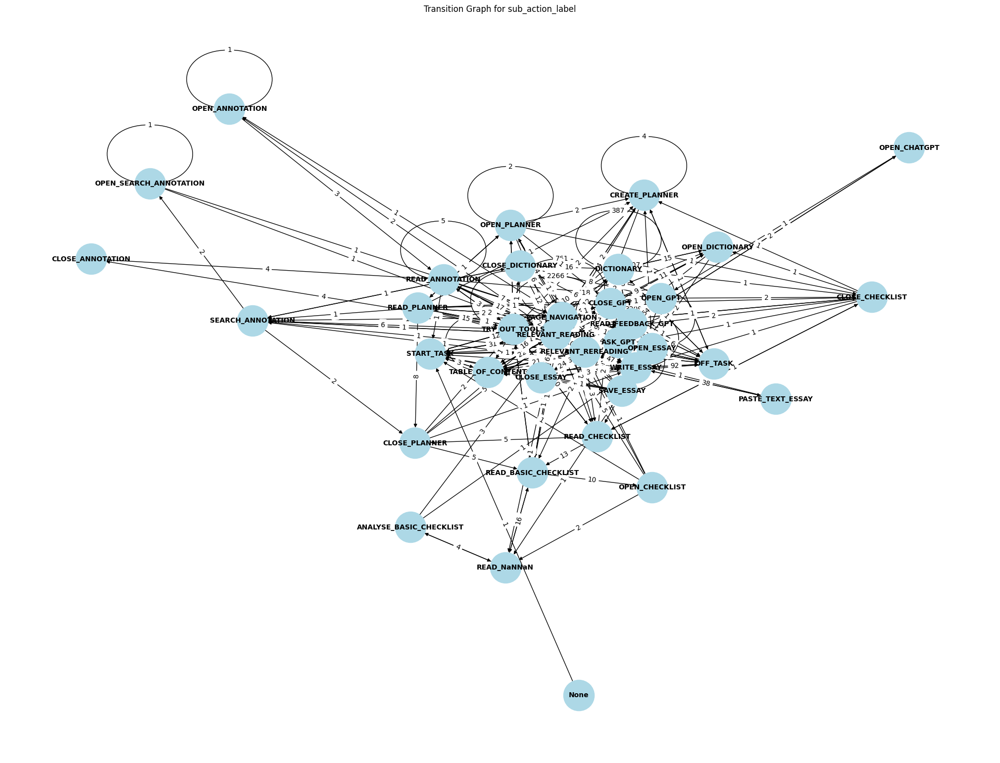

In [44]:
def process_analytics(df, feature):
    # Create a directed graph
    G = nx.DiGraph()
    # Count transitions
    transitions = df[feature].shift().astype(str) + ' -> ' + df[feature].astype(str)
    transition_counts = transitions.value_counts()
    # Add edges to the graph
    for transition, count in transition_counts.items():
        from_node, to_node = transition.split(' -> ')
        G.add_edge(from_node, to_node, weight=count)

    # Draw the graph
    plt.figure(figsize=(20, 15))  # Increase the figure size
    pos = nx.spring_layout(G)
    weights = nx.get_edge_attributes(G, 'weight')
    nx.draw(G, pos, with_labels=True, node_size=2000, node_color='lightblue', font_size=10, font_weight='bold')
    nx.draw_networkx_edge_labels(G, pos, edge_labels=weights)
    plt.title(f'Transition Graph for {feature}')
    plt.show()

# Example usage
#data = {
#    'Category': ['A', 'B', 'A', 'C', 'B', 'A', 'C', 'A', 'B', 'C']
#}
#df = pd.DataFrame(data)
process_analytics(Trace, 'sub_action_label')


It did clean it to some extent lets now see if increasing the distance between each node does the trick

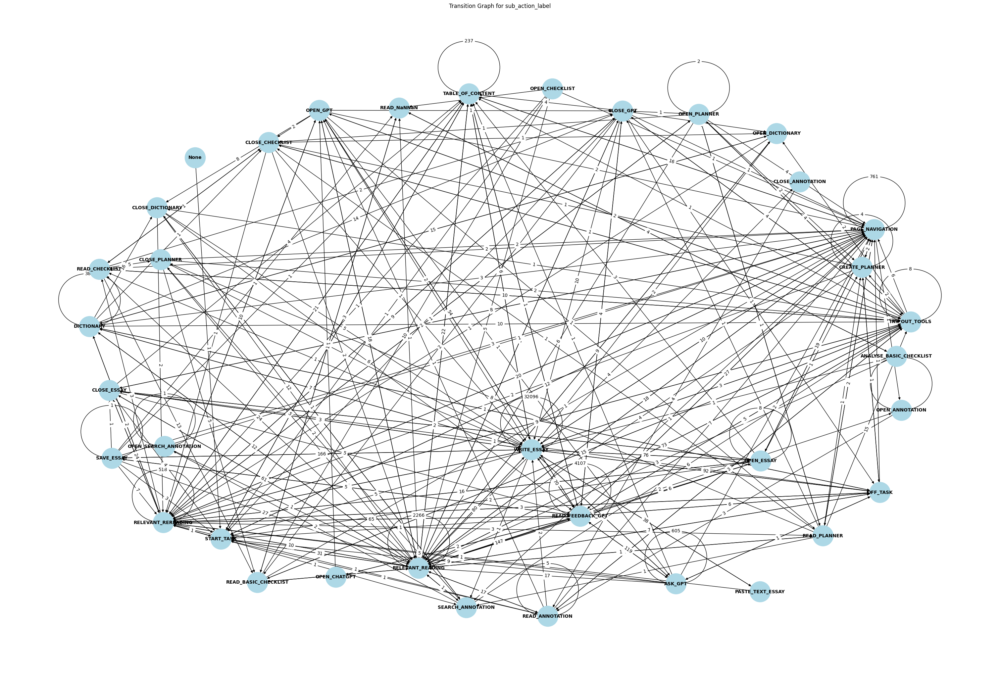

In [45]:
def process_analytics(df, feature):
    # Create a directed graph
    G = nx.DiGraph()
    # Count transitions
    transitions = df[feature].shift().astype(str) + ' -> ' + df[feature].astype(str)
    transition_counts = transitions.value_counts()
    # Add edges to the graph
    for transition, count in transition_counts.items():
        from_node, to_node = transition.split(' -> ')
        G.add_edge(from_node, to_node, weight=count)

    # Draw the graph
    plt.figure(figsize=(30, 20))  # Increase the figure size
    pos = nx.spring_layout(G, k=7)  # Increase the k value to space nodes further apart
    weights = nx.get_edge_attributes(G, 'weight')
    nx.draw(G, pos, with_labels=True, node_size=2000, node_color='lightblue', font_size=10, font_weight='bold')
    nx.draw_networkx_edge_labels(G, pos, edge_labels=weights)
    plt.title(f'Transition Graph for {feature}')
    plt.show()

# Example usage
# data = {
#    'Category': ['A', 'B', 'A', 'C', 'B', 'A', 'C', 'A', 'B', 'C']
#}
# df = pd.DataFrame(data)
process_analytics(Trace, 'sub_action_label')  # Corrected the argument from 'sub_action_label' to 'Category'


This is graph but we can still not see the frequencies connecting the node

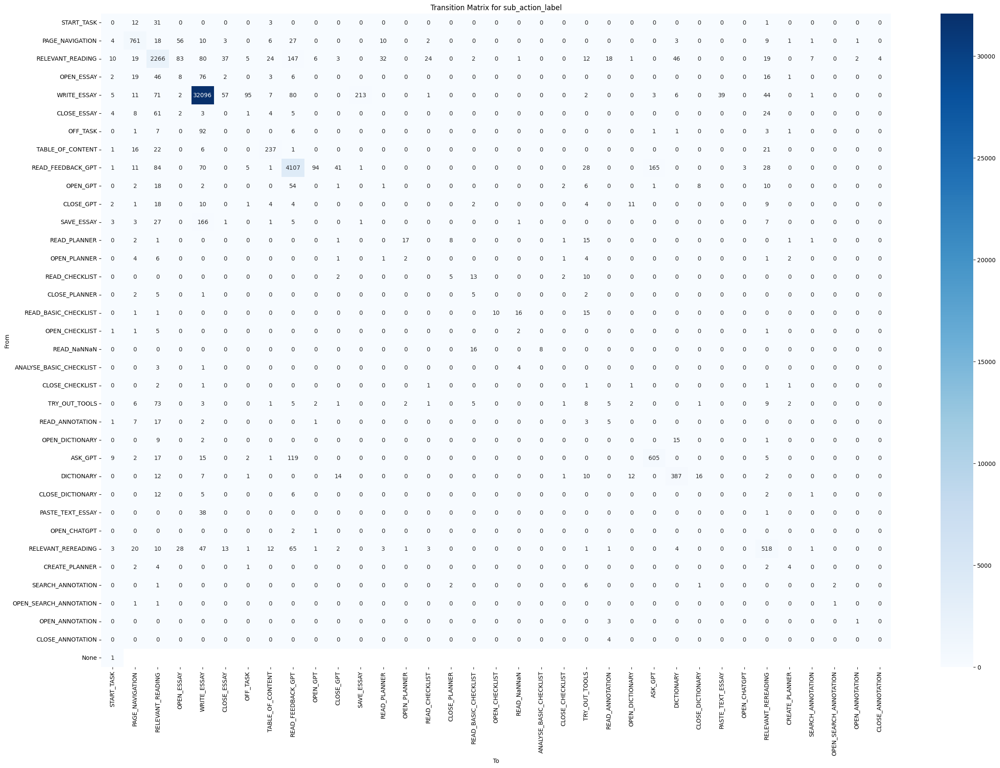

In [46]:
def process_analytics(df, feature):
    # Create a transition matrix
    transition_matrix = pd.DataFrame(0, index=df[feature].unique(), columns=df[feature].unique())

    # Count transitions
    transitions = df[feature].shift().astype(str) + ' -> ' + df[feature].astype(str)
    transition_counts = transitions.value_counts()

    # Fill the transition matrix
    for transition, count in transition_counts.items():
        from_node, to_node = transition.split(' -> ')
        transition_matrix.loc[from_node, to_node] = count

    # Plot the heatmap
    plt.figure(figsize=(30, 20))
    sns.heatmap(transition_matrix, annot=True, fmt='g', cmap='Blues', cbar=True)
    plt.title(f'Transition Matrix for {feature}')
    plt.xlabel('To')
    plt.ylabel('From')
    plt.show()

# Example usage
data = {
    'Category': ['A', 'B', 'A', 'C', 'B', 'A', 'C', 'A', 'B', 'C']
}
df = pd.DataFrame(data)
process_analytics(Trace, 'sub_action_label')


Write essay is dominating the heat map. Lets see if log scaling can help find other significant connecitons

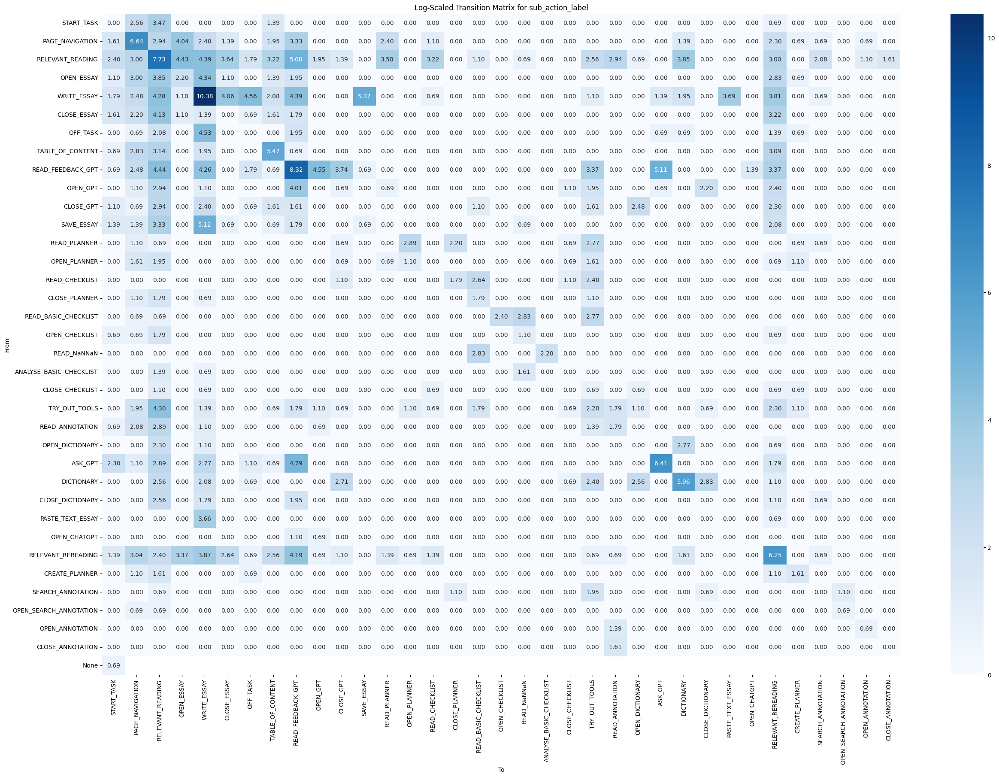

In [47]:
def process_analytics(df, feature):
    # Create a transition matrix
    transition_matrix = pd.DataFrame(0, index=df[feature].unique(), columns=df[feature].unique())

    # Count transitions
    transitions = df[feature].shift().astype(str) + ' -> ' + df[feature].astype(str)
    transition_counts = transitions.value_counts()

    # Fill the transition matrix
    for transition, count in transition_counts.items():
        from_node, to_node = transition.split(' -> ')
        transition_matrix.loc[from_node, to_node] = count

    # Apply log scaling (using log1p to handle zero values)
    log_transition_matrix = np.log1p(transition_matrix)

    # Plot the heatmap
    plt.figure(figsize=(30, 20))
    sns.heatmap(log_transition_matrix, annot=True, fmt='.2f', cmap='Blues', cbar=True)
    plt.title(f'Log-Scaled Transition Matrix for {feature}')
    plt.xlabel('To')
    plt.ylabel('From')
    plt.show()

# Example usage
data = {
    'Category': ['A', 'B', 'A', 'C', 'B', 'A', 'C', 'A', 'B', 'C']
}
df = pd.DataFrame(data)
process_analytics(Trace, 'sub_action_label')


Its now good for reading the significances of connections.

### Introducing Threshold parameter so only the edges that are above it are displayed.

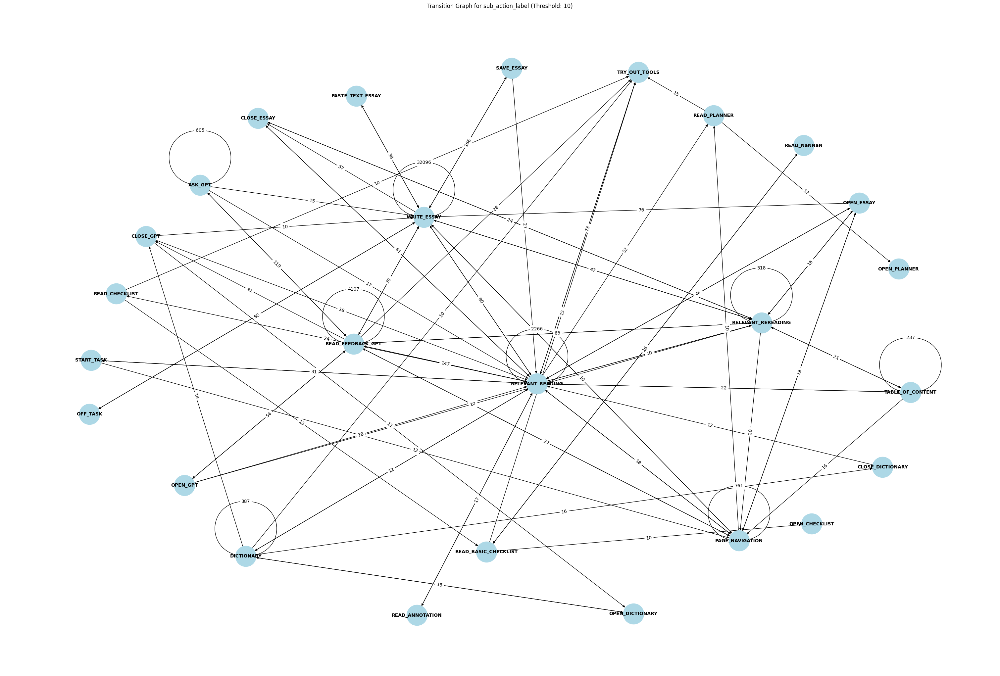

In [59]:
def process_analytics(df, feature, threshold=1):
    # Create a directed graph
    G = nx.DiGraph()

    # Count transitions
    transitions = df[feature].shift().astype(str) + ' -> ' + df[feature].astype(str)
    transition_counts = transitions.value_counts()

    # Add edges to the graph only if the count exceeds the threshold
    for transition, count in transition_counts.items():
        if count >= threshold:  # Check if the count meets the threshold
            from_node, to_node = transition.split(' -> ')
            G.add_edge(from_node, to_node, weight=count)

    # Draw the graph
    plt.figure(figsize=(30, 20))  # Increase the figure size
    pos = nx.spring_layout(G, k=7)  # Increase the k value to space nodes further apart
    weights = nx.get_edge_attributes(G, 'weight')

    # Draw the graph only if there are edges
    if G.number_of_edges() > 0:
        nx.draw(G, pos, with_labels=True, node_size=2000, node_color='lightblue', font_size=10, font_weight='bold')
        nx.draw_networkx_edge_labels(G, pos, edge_labels=weights)
    else:
        print("No edges meet the threshold criteria.")

    plt.title(f'Transition Graph for {feature} (Threshold: {threshold})')
    plt.show()

# Example usage
# data = {
#    'Category': ['A', 'B', 'A', 'C', 'B', 'A', 'C', 'A', 'B', 'C']
#}
# df = pd.DataFrame(data)
process_analytics(Trace, 'sub_action_label', threshold=10)  # Adjust the threshold as needed


### The Edges are displaying Probabilites instead of raw frequencies.

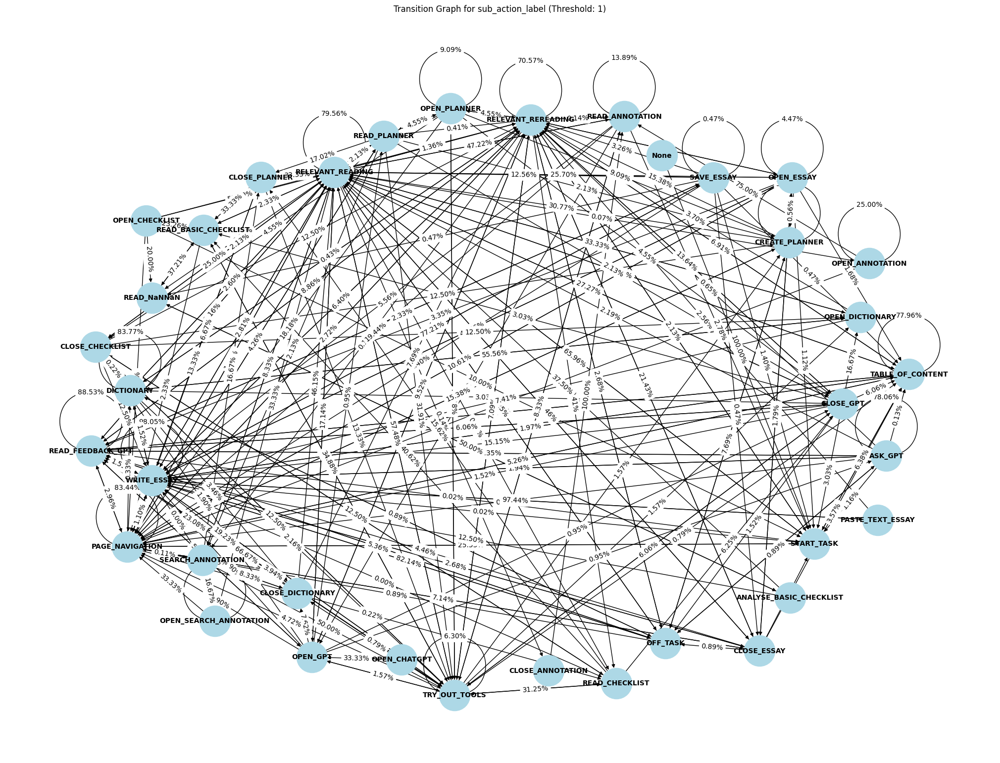

In [60]:
def process_analytics(df, feature, threshold=1):
    # Create a directed graph
    G = nx.DiGraph()

    # Count transitions
    transitions = df[feature].shift().astype(str) + ' -> ' + df[feature].astype(str)
    transition_counts = transitions.value_counts()

    # Create a dictionary to hold the total counts for each source node
    total_counts = transition_counts.groupby(lambda x: x.split(' -> ')[0]).sum()

    # Add edges to the graph only if the count exceeds the threshold
    for transition, count in transition_counts.items():
        if count >= threshold:  # Check if the count meets the threshold
            from_node, to_node = transition.split(' -> ')
            # Calculate the probability
            probability = count / total_counts[from_node]
            G.add_edge(from_node, to_node, weight=probability)

    # Draw the graph
    plt.figure(figsize=(20, 15))  # Increase the figure size
    pos = nx.spring_layout(G, k=2)  # Increase the k value to space nodes further apart
    weights = nx.get_edge_attributes(G, 'weight')

    # Draw the graph only if there are edges
    if G.number_of_edges() > 0:
        nx.draw(G, pos, with_labels=True, node_size=2000, node_color='lightblue', font_size=10, font_weight='bold')
        nx.draw_networkx_edge_labels(G, pos, edge_labels={k: f"{v:.2%}" for k, v in weights.items()})  # Format probabilities as percentages
    else:
        print("No edges meet the threshold criteria.")

    plt.title(f'Transition Graph for {feature} (Threshold: {threshold})')
    plt.show()

# Example usage
# data = {
#    'Category': ['A', 'B', 'A', 'C', 'B', 'A', 'C', 'A', 'B', 'C']
#}
# df = pd.DataFrame(data)
process_analytics(Trace, 'sub_action_label', threshold=1)  # Adjust the threshold as needed
